In [1]:
import itertools
import json
import re
import sys
from pathlib import Path

import pandas as pd
import numpy as np
from tqdm import tqdm 

import statsmodels.api as sm
from statsmodels.miscmodels.ordinal_model import OrderedModel
from statsmodels.stats.proportion import proportions_ztest, proportions_ztost
from statsmodels.stats.weightstats import ttest_ind, ttost_ind

from scipy.stats import pearsonr, spearmanr, mannwhitneyu

# Setup
## Load data

In [2]:
DATA_DIR = "../data/human/all_data"
DATA_FILE = "all_data.csv"

FILTER_ON_FAMILIARITY = False

familiar = "_familiar" if FILTER_ON_FAMILIARITY else ""

In [4]:
auto_metric_names = [
 'c_npmi_10_full',
 'c_npmi_10_nytimes_full',
 #'c_npmi_10_test',
 'c_npmi_10_train',
 'c_npmi_10_val',
 'c_npmi_10_wikitext_full',
 #'c_uci_full',
 'c_v_full',
 'c_v_nytimes_full',
 #'c_v_test',
 'c_v_train',
 'c_v_val',
 'c_v_wikitext_full',
 #'u_mass_full'
]

In [3]:
task_data = pd.read_csv(Path(DATA_DIR, DATA_FILE))

# complete the out-of-sample columns
for dataset in ["wikitext", "nytimes"]:
    for metric in ["c_npmi_10", "c_v"]:
        task_data[f"{metric}_{dataset}_full"] = task_data[f"{metric}_{dataset}_full"].combine_first(task_data[f"{metric}_full"])

# add the constant for lin. reg
task_data = sm.add_constant(task_data)

# convert infinite values to nans
task_data = task_data.replace(np.inf, np.nan)


In [5]:
task_data.groupby(['dataset', 'model', 'topic_idx']).head(1).groupby(['dataset', 'model'])[['c_npmi_10_full', 'c_v_full']].agg(['mean', 'std', 'max', 'min'])

c_npmi_10_full                                c_v_full  \
                          mean       std       max       min      mean   
dataset  model                                                           
nytimes  dvae         0.253596  0.133007  0.587569 -0.094053  0.844652   
         etm          0.113789  0.091805  0.503146 -0.009921  0.605142   
         mallet       0.158110  0.080070  0.477645  0.004670  0.694020   
wikitext dvae         0.223753  0.087305  0.413731  0.024347  0.841277   
         etm          0.113287  0.068640  0.255679 -0.008955  0.637257   
         mallet       0.135579  0.051554  0.239696  0.038180  0.680515   

                                               
                      std       max       min  
dataset  model                                 
nytimes  dvae    0.129879  0.983422  0.238655  
         etm     0.156325  0.893091  0.350617  
         mallet  0.114493  0.869635  0.377322  
wikitext dvae    0.097088  0.969713  0.488793  
         etm     0.140696  0.866764  0.360705  
         mallet  0.098450  0.892273  0.485520

In [23]:
pearsonr(grouped.c_v_full, grouped.confidences_raw)

(-0.29313968066370516, 2.3390327587317058e-07)

## Helper functions

In [6]:
def find_max_values(values, lbs, ubs):
    """
    Given arrays of `values` and associated lower (`lbs`) and upper bounds (`ubs`),
    for confidence intervals, return binary array of indices of `values` that have 
    CIs that overlap with the CI of the maximum value.
    """
    n = len(values)
    values = np.nan_to_num(values, nan=0)
    lbs = np.nan_to_num(lbs, nan=0)
    ubs = np.nan_to_num(ubs, nan=0)
    sorted_value_idx = np.argsort(values)[::-1]
    max_lbs = lbs[sorted_value_idx[0]]
    for i, idx in enumerate(sorted_value_idx[1:], start=1):
        # is the upper bound of this value contained in the
        # lower bound of the largest coefficient?
        if ubs[idx] < max_lbs:
            return np.array([j in sorted_value_idx[:i] for j in range(n)])
    return np.full(n, True)

def find_min_values(values, lbs, ubs):
    """
    Analogous to `find_max_values`
    """
    return find_max_values(-values, -ubs, -lbs, contiguous=contiguous)

def ci_lb(x):
    return np.quantile(x, 0.025)

def ci_ub(x):
    return np.quantile(x, 0.975)

In [7]:
LATEX_CLEANUP = {
    "c_v": r"$C_v$ (110-token window)",
    "test": "Test",
    "c_npmi_10": r"\abr{npmi} (10-token window)",
    "nytimes_full": r"\abr{nyt}",
    "wikitext_full": r"\abr{wiki}",
    "wikitext": r"\abr{wiki}",
    "nytimes": r"\abr{nyt}",
    "all": "Concatenated",
    "full": "Full",
    "train": "Train",
    "val": "Val",
    "test": "Test",
    "ratings": "Rating",
    "intrusions": "Intrusion",
    "metric": "",
    "dataset": r"Train Corpus $\downarrow$",
    "reference": r"Ref. Corpus $\rightarrow$",
    "task": "",
}

# Bootstrapped correlations

In [8]:
ALPHA = 0.05
N_ITERS = 1000
NUM_ANNOTATORS = {"intrusions": 26, "ratings": 15}
DROP_NA = False

np.random.seed(42)
rows = []

familiar_filter = (task_data.confidences_raw == 1) if FILTER_ON_FAMILIARITY else True
        
for iteration in tqdm(range(N_ITERS), total=N_ITERS):
    for task in ["ratings", "intrusions"]:
        # sample
        resampled = (
            task_data.loc[(task_data.task == task) & (familiar_filter)]
                     .groupby(["task", "dataset", "model", "topic_idx"], as_index=False)
                     .sample(NUM_ANNOTATORS[task], replace=True)
                     .groupby(["task", "dataset", "model", "topic_idx"], as_index=False)[auto_metric_names + ["scores_raw"]]
                     .mean()
        )
        for dataset in ["wikitext", "nytimes", "all"]:
            data_df = resampled.copy()
            if dataset != "all":
                data_df = data_df.loc[data_df.dataset == dataset]
    
            # run correlations for each metric
            for i, metric in enumerate(auto_metric_names):
                if dataset in metric:
                    continue # don't re-do the internal
                if DROP_NA:
                    df = data_df.dropna(subset=[metric])
                else:
                    df = data_df.fillna(0)
                
                spear_rho, spear_p = spearmanr(df[metric].values, df["scores_raw"].values)
                pear_rho, pear_p = pearsonr(df[metric].values, df["scores_raw"].values)
                metric_base = re.search("c_npmi_10|c_v|c_uci|u_mass", metric).group(0)
                row = {
                    "task": task,
                    "dataset": dataset,
                    "metric": metric_base,
                    "reference": metric.replace(f"{metric_base}_", ""),
                    "spear_rho": spear_rho,
                    "pear_rho": pear_rho,
                    "spear_p": spear_p,
                    "pear_p": pear_p,
                }
                rows.append(row)
correlations = pd.DataFrame(rows)
correlations.to_csv(f"correlation_results{familiar}.csv", index=False)

100%|██████████| 1000/1000 [12:20<00:00,  1.35it/s]


## Create table

In [9]:
correlations = pd.read_csv(f"correlation_results{familiar}.csv")
correlations.loc[(correlations.dataset=="wikitext") & (correlations.reference == "full"), "reference"] = "wikitext_full"
correlations.loc[(correlations.dataset=="nytimes") & (correlations.reference == "full"), "reference"] = "nytimes_full"

In [10]:
VALUE_COL = "spear_rho"
METRICS_TO_KEEP = ["c_npmi_10", "c_v"]

In [11]:
correlations_grouped = (
    correlations.groupby(["task", "dataset", "metric", "reference"])[VALUE_COL]
               .agg(["mean", "std", ci_lb, ci_ub])
               .reset_index()
               .rename(columns={"mean": VALUE_COL, "ci_lb": "ci_0.025", "ci_ub": "ci_0.975"})
)

In [12]:
correlations_pivot = (
    correlations_grouped.loc[correlations_grouped.metric.isin(METRICS_TO_KEEP)]
               .sort_values(["task", "dataset", "metric", "reference"])
               .pivot(index=["task", "dataset"], columns=["metric", "reference"], values=[VALUE_COL, "ci_0.025",  "ci_0.975"])
)
correlations_pivot = correlations_pivot[[
    (v, m, r)
    for v in [VALUE_COL, "ci_0.025",  "ci_0.975"]
    for m in METRICS_TO_KEEP
    for r in ["nytimes_full", "wikitext_full", "train", "val"]
]]

In [13]:
for idx, row in correlations_pivot.iterrows():
    # determine overlapping CIs
    max_values = find_max_values(row[VALUE_COL], row["ci_0.025"], row["ci_0.975"])
    newrow = []
    # format each item in the row,
    # bold for max value, underline for overlapping
    for i, x in enumerate(row[VALUE_COL]):
        if np.isnan(x):
            val = "-"
        elif not np.isnan(x) and max_values[i]:
            val = r"\uline{" + f"{x:0.2f}" + "}"
            if x == np.max(row[VALUE_COL]):
                val = r"\textbf{" + val + "}"
        else:
            val = f"{x:0.2f}"
        newrow.append(val)
    correlations_pivot.at[idx, VALUE_COL] = newrow

In [14]:
# make latex
correlations_pivot_values = correlations_pivot[VALUE_COL].loc[[
    ('intrusions',  'nytimes'),
    ('intrusions', 'wikitext'),
    ('intrusions',      'all'),
    (   'ratings',  'nytimes'),
    (   'ratings', 'wikitext'),
    (   'ratings',      'all'),
]]
latex = correlations_pivot_values.to_latex(escape=False, multicolumn_format='c', column_format="ll|rrrr|rrrr")
for to_replace, val in LATEX_CLEANUP.items():
    latex = latex.replace(to_replace, val)
print(latex)


\begin{tabular}{ll|rrrr|rrrr}
\toprule
        &  & \multicolumn{4}{c}{\abr{npmi} (10-token window)} & \multicolumn{4}{c}{$C_v$ (110-token window)} \\
        & Ref. Corpus $\rightarrow$ &  \abr{nyt} &          \abr{wiki} &         Train &   Val &  \abr{nyt} &          \abr{wiki} &         Train &   Val \\
 & Train Corpus $\downarrow$ &               &                        &               &       &               &                        &               &       \\
\midrule
Intrusion & \abr{nyt} &          0.34 &           \uline{0.51} &          0.32 &  0.25 &          0.44 &  \textbf{\uline{0.55}} &          0.42 &  0.38 \\
        & \abr{wiki} &  \uline{0.39} &           \uline{0.39} &  \uline{0.40} &  0.14 &  \uline{0.38} &  \textbf{\uline{0.40}} &  \uline{0.39} &  0.13 \\
        & Concatenated &          0.36 &           \uline{0.45} &          0.36 &  0.18 &          0.41 &  \textbf{\uline{0.48}} &          0.41 &  0.26 \\
Rating & \abr{nyt} &          0.45 &  \textbf{\uline{0.5

# Simple Simulation

In [57]:
def select_random_topics(data_df, topic_df, num_topics=50, replace=True):
    """
    Sample `num_topics` random topics, with optional replacement, for each (task, dataset)
    """
    # first we need to pool the original models together then partition the unique topics into two sets
    n = (topic_df.topic_idx.nunique() * topic_df.model.nunique())// 2
    # randomly assign each of these unique topics to a new "model", by dataset
    topic_df['pseudo_model'] = (
        topic_df.groupby('dataset')['model']
                .transform(lambda x: np.random.permutation(np.repeat(['model_a', 'model_b'], [n, n])))
    )
    # give each topic a unique id, given the new assignments
    topic_df["pseudo_topic_idx"] = topic_df.groupby(["dataset", "pseudo_model"]).cumcount()

    # now, randomly subsample `num_topics` within each model
    topic_sample = topic_df.groupby(["dataset", "pseudo_model"]).sample(num_topics, replace=replace)
    # give a new unique id---the index of the sampled topic
    topic_sample["rand_topic_idx"] = topic_sample.groupby(["dataset", "pseudo_model"]).cumcount()

    # merge this new data back into the old data and assign new model and topic ids
    data_df = data_df.merge(topic_sample, how='inner')
    data_df["model"] = data_df["pseudo_model"]
    data_df["topic_idx"] = data_df["pseudo_topic_idx"]

    return data_df

def proportion_test(scores_a, scores_b, alternative, h0=0):
    """
    Proportions test of difference, used for intrusion scores
    """
    return proportions_ztest(
        [scores_a.sum(), scores_b.sum()],
        [len(scores_a), len(scores_b)],
        value=h0,
        alternative=alternative,
    )

def t_test(scores_a, scores_b, alternative, h0=0):
    """
    T-test of difference in means
    """
    return ttest_ind(
        scores_a,
        scores_b,
        usevar='unequal',
        value=h0,
        alternative=alternative,
    )[:2]

def false_discovery_rate_sim(
    task,
    test_df,
    metric,
    alpha=0.05,
    equiv_human=None,
    equiv_auto=0.01,
    exact=False,
):
    """
    Given a sample of data, determine the number of times
    that auto metrics imply a significant difference between models
    when the human scores do not.
    """
    false_positives, false_negatives = 0, 0
    discoveries, omissions = 0, 0
    diff_data = {}
    stat_test = proportion_test if task == "intrusions" else t_test

    # model scores are the same across all the human ratings
    model_scores = test_df.groupby(['task', 'dataset', 'model', 'rand_topic_idx']).head(1)

    # Run significance tests in both directions
    model_data = {
        "a": {
            "auto": model_scores.loc[model_scores.model=="model_a"][metric],
            "human": test_df.loc[test_df.model=="model_a"]["scores_raw"],
        },
        "b": {
            "auto": model_scores.loc[model_scores.model=="model_b"][metric],
            "human": test_df.loc[test_df.model=="model_b"]["scores_raw"],
        },
    }

    for i, j in [["a", "b"], ["b", "a"]]:
        if not exact:
            # run the tests for both human and auto metrics
            _, p_diff_auto = t_test(model_data[i]["auto"], model_data[j]["auto"], alternative="larger", h0=0)
            _, p_equiv_auto = t_test(model_data[i]["auto"], model_data[j]["auto"], alternative="smaller", h0=equiv_auto)

            _, p_diff_human = stat_test(model_data[i]["human"], model_data[j]["human"], alternative="larger", h0=0)
            _, p_equiv_human = stat_test(model_data[i]["human"], model_data[j]["human"], alternative="smaller", h0=equiv_human)

            # tests flawed
            if p_equiv_human < alpha and p_diff_human < alpha:
                continue
            if p_equiv_auto < alpha and p_diff_auto < alpha:
                continue

            # equivalence test / ttost
            if p_diff_auto < alpha:
                discoveries += 1
                if p_equiv_human < alpha:
                    false_positives += 1

            if p_diff_human < alpha:
                omissions += 1
                if p_equiv_auto < alpha:
                    false_negatives += 1
        
        else:
            # the "exact" test
            if model_data[i]["auto"].mean() - model_data[j]["auto"].mean() > 0:
                discoveries += 1
                if model_data[i]["human"].mean() - model_data[j]["human"].mean() < 0:
                    false_positives += 1

            if model_data[i]["human"].mean() - model_data[j]["human"].mean() > 0:
                omissions += 1
                if model_data[i]["auto"].mean() - model_data[j]["auto"].mean() < 0:
                    false_negatives += 1

        mean_auto_diff = model_data[i]["auto"].mean() - model_data[j]["auto"].mean()
        if mean_auto_diff > 0: # pick the direction where auto difference is higher
            diff_data = {
                "mean_auto_diff": mean_auto_diff,
                "mean_human_diff": model_data[i]["human"].mean() - model_data[j]["human"].mean(),
                "p_diff_auto": p_diff_auto,
                "p_diff_human": p_diff_human,
            }

    return {
        "discoveries": discoveries,
        "false_positives": false_positives,
        "omissions": omissions,
        "false_negatives": false_negatives,
        **diff_data,
    }

In [58]:
ALPHA = 0.05
N_ITERS = 5000
NUM_ANNOTATORS = {"intrusions": 26, "ratings": 15}

NUM_TOPICS = 50
# NB: neither resample setting makes much empirical difference
RESAMPLE_TOPICS = True
RESAMPLE_HUMAN = True

# 4 bad topics
# EQUIVALENCE_THRESHOLD = {"intrusions": 0.08, "ratings": 0.16, "auto": 0.08}
# 1 bad topic
# EQUIVALENCE_THRESHOLD = {"intrusions": 0.02, "ratings": 0.04, "auto": 0.01}
# from power---clear 0.9
EQUIVALENCE_THRESHOLD = {"intrusions": 0.05, "ratings": 0.11, "c_npmi_10": 0.05, "c_v": 0.06}

np.random.seed(42)
rows = []

# group to the unique topic level
topic_df = task_data.groupby(["dataset", "model", "topic_idx"], as_index=False).size()
topic_df = topic_df.drop(columns='size')

task_data['uniq_topic_id'] = task_data.dataset + "_" + task_data.model + "_" + task_data.topic_idx.astype(str)

for iteration in tqdm(range(N_ITERS), total=N_ITERS):
    resampled = task_data.copy().fillna(0)
    if FILTER_ON_FAMILIARITY:
        resampled = resampled.loc[resampled.confidences_raw == 1]
    resampled = select_random_topics(
        data_df=resampled,
        topic_df=topic_df,
        num_topics=NUM_TOPICS,
        replace=RESAMPLE_TOPICS,
    )
    
    # resample human scores at the topic level
    for task in ["ratings", "intrusions"]:
        task_df = resampled.loc[resampled.task == task]
        if RESAMPLE_HUMAN:
            task_df = (
                task_df.groupby(["task", "dataset", "model", "rand_topic_idx"])
                       .sample(NUM_ANNOTATORS[task], replace=True)
            )

        for dataset in ["wikitext", "nytimes", "all"]:
            data_df = task_df
            eq_factor = 0.75
            if dataset != "all":
                data_df = task_df.loc[data_df.dataset == dataset]
                eq_factor = 1.

            for i, metric in enumerate(auto_metric_names):
                if dataset in metric:
                    continue # don't re-do the internal for `wikitext_full`, `nytimes_full`
                metric_base = re.search("c_npmi_10|c_v|c_uci|u_mass", metric).group(0)

                result = false_discovery_rate_sim(
                    task,
                    data_df,
                    metric,
                    alpha=ALPHA,
                    equiv_human=EQUIVALENCE_THRESHOLD[task] * eq_factor,
                    equiv_auto=EQUIVALENCE_THRESHOLD[metric_base] * eq_factor,
                )

                row = {
                    "task": task,
                    "dataset": dataset,
                    "metric": metric_base,
                    "reference": metric.replace(f"{metric_base}_", ""),
                    **result
                }
                rows.append(row)
simulations = pd.DataFrame(rows)
simulations.to_csv(f"simple_simulation_results{familiar}.csv", index=False)

100%|██████████| 5000/5000 [1:21:00<00:00,  1.03it/s]


## Create latex table

In [5]:
simulations = pd.read_csv(f"simple_simulation_results{familiar}.csv")

In [59]:
simulations.loc[(simulations.dataset=="wikitext") & (simulations.reference == "full"), "reference"] = "wikitext_full"
simulations.loc[(simulations.dataset=="nytimes") & (simulations.reference == "full"), "reference"] = "nytimes_full"

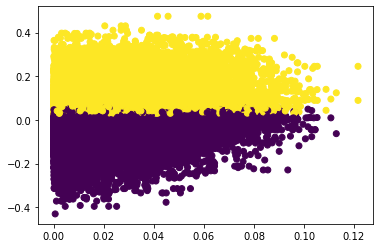

In [69]:
import matplotlib.pyplot as plt

simulations['sig_human'] = simulations.p_diff_human < ALPHA
plot_df = simulations.loc[simulations.metric == "c_npmi_10"]
plt.scatter(plot_df.mean_auto_diff, plot_df.mean_human_diff, c=(plot_df.p_diff_human < ALPHA))

In [70]:
plot_df

,task,dataset,metric,reference,discoveries,false_positives,omissions,false_negatives,mean_auto_diff,mean_human_diff,p_diff_auto,p_diff_human,sig_human
0,ratings,wikitext,c_npmi_10,wikitext_full,0,0,1,1,0.021174,0.277333,0.105176,1.830285e-17,True
1,ratings,wikitext,c_npmi_10,nytimes_full,0,0,1,0,0.020634,0.277333,0.125324,1.830285e-17,True
2,ratings,wikitext,c_npmi_10,train,1,0,1,0,0.027826,0.277333,0.043522,1.830285e-17,True
3,ratings,wikitext,c_npmi_10,val,0,0,1,1,0.004193,-0.277333,0.436161,1.000000e+00,False
8,ratings,nytimes,c_npmi_10,nytimes_full,0,0,1,1,0.006290,-0.068000,0.386663,9.777026e-01,False
...,...,...,...,...,...,...,...,...,...,...,...,...,...
259990,intrusions,all,c_npmi_10,full,0,0,1,1,0.006712,-0.029615,0.309727,9.898425e-01,False
259991,intrusions,all,c_npmi_10,nytimes_full,0,0,1,1,0.007167,-0.029615,0.303311,9.898425e-01,False
259992,intrusions,all,c_npmi_10,train,0,0,1,1,0.001166,-0.029615,0.467541,9.898425e-01,False
259993,intrusions,all,c_npmi_10,val,0,0,1,1,0.002257,0.029615,0.450090,1.015748e-02,True


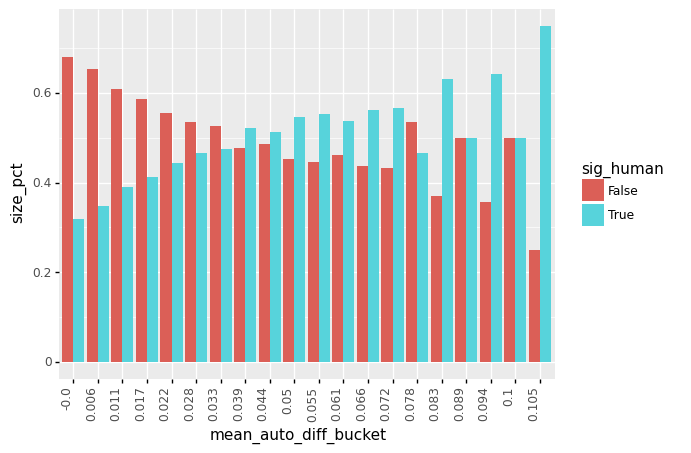

<ggplot: (8779343695159)>

In [79]:
from plotnine import ggplot, geom_histogram, aes, after_stat, geom_bar, theme, element_text

plot_df = simulations.loc[(simulations.metric == "c_npmi_10") & (simulations.reference == "train")]
plot_df = plot_df.dropna()
plot_df['mean_auto_diff_bucket'] = pd.cut(plot_df.mean_auto_diff, bins=20).apply(lambda x: x.left.round(3))
#plot_df['mean_auto_diff_bucket'] = pd.cut(plot_df.mean_auto_diff, bins=np.quantile(plot_df.mean_auto_diff, np.linspace(0, 1, 20)), include_lowest=True).apply(lambda x: x.left)
plot_df = plot_df.groupby(['mean_auto_diff_bucket', 'sig_human'], as_index=False).size()
plot_df["size_pct"] = plot_df["size"] / plot_df.groupby(["mean_auto_diff_bucket"])["size"].transform("sum")
(
    ggplot(plot_df, aes(x='mean_auto_diff_bucket', y='size_pct', fill='sig_human')) +
    geom_bar(stat='identity', position='dodge') +
    theme(axis_text_x=element_text(rotation=90, hjust=1))
)

In [38]:
simulations.loc[~simulations.mean_auto_diff.isnull() & ~(simulations.reference == "val")].groupby(['dataset', 'metric', 'reference'])[['mean_auto_diff', 'mean_human_diff']].agg(['mean', 'std', 'min', 'max']).round(3)

mean_auto_diff                     \
                                           mean    std  min    max   
dataset  metric    reference                                         
all      c_npmi_10 full                   0.012  0.009  0.0  0.046   
                   nytimes_full           0.012  0.009  0.0  0.050   
                   train                  0.012  0.009  0.0  0.050   
                   wikitext_full          0.012  0.009  0.0  0.046   
         c_v       full                   0.018  0.014  0.0  0.074   
                   nytimes_full           0.018  0.014  0.0  0.080   
                   train                  0.018  0.014  0.0  0.076   
                   wikitext_full          0.018  0.014  0.0  0.080   
nytimes  c_npmi_10 nytimes_full           0.019  0.014  0.0  0.079   
                   train                  0.020  0.015  0.0  0.079   
                   wikitext_full          0.020  0.014  0.0  0.073   
         c_v       nytimes_full           0.028  0.021  0.0  0.120   
                   train                  0.028  0.022  0.0  0.123   
                   wikitext_full          0.029  0.022  0.0  0.119   
wikitext c_npmi_10 nytimes_full           0.014  0.011  0.0  0.053   
                   train                  0.014  0.010  0.0  0.056   
                   wikitext_full          0.013  0.010  0.0  0.054   
         c_v       nytimes_full           0.025  0.019  0.0  0.099   
                   train                  0.023  0.018  0.0  0.092   
                   wikitext_full          0.022  0.017  0.0  0.092   

                                 mean_human_diff                       
                                            mean    std    min    max  
dataset  metric    reference                                           
all      c_npmi_10 full                    0.010  0.052 -0.221  0.205  
                   nytimes_full            0.010  0.052 -0.221  0.205  
                   train                   0.010  0.052 -0.221  0.205  
                   wikitext_full           0.011  0.052 -0.221  0.205  
         c_v       full                    0.015  0.051 -0.204  0.221  
                   nytimes_full            0.014  0.051 -0.204  0.221  
                   train                   0.016  0.050 -0.204  0.221  
                   wikitext_full           0.016  0.050 -0.167  0.221  
nytimes  c_npmi_10 nytimes_full            0.020  0.078 -0.284  0.332  
                   train                   0.019  0.078 -0.284  0.332  
                   wikitext_full           0.020  0.078 -0.285  0.332  
         c_v       nytimes_full            0.028  0.076 -0.275  0.332  
                   train                   0.028  0.076 -0.275  0.332  
                   wikitext_full           0.030  0.075 -0.249  0.332  
wikitext c_npmi_10 nytimes_full            0.014  0.067 -0.204  0.280  
                   train                   0.022  0.065 -0.204  0.280  
                   wikitext_full           0.020  0.066 -0.204  0.280  
         c_v       nytimes_full            0.016  0.067 -0.204  0.280  
                   train                   0.023  0.065 -0.203  0.280  
                   wikitext_full           0.022  0.065 -0.203  0.280

In [60]:
METRICS_TO_KEEP = ["c_npmi_10", "c_v"]

simulations_grouped = (
    simulations.groupby(["task", "dataset", "metric", "reference"])[["false_positives", "discoveries", 'false_negatives', 'omissions']]
               .agg(["sum"])
               .reset_index()
)
simulations_grouped["fp_rate"] = (simulations_grouped["false_positives"]*(1 - ALPHA)) / simulations_grouped["discoveries"]
simulations_grouped["fn_rate"] = (simulations_grouped["false_negatives"]*(1 - ALPHA)) / simulations_grouped["omissions"]

In [66]:
simulations_pivot = (
    simulations_grouped.loc[simulations_grouped.metric.isin(METRICS_TO_KEEP)]
               .sort_values(["task", "dataset", "metric", "reference"])
               .pivot(index=["task", "dataset"], columns=["metric", "reference"], values=["fp_rate", "fn_rate"])
)
simulations_pivot = simulations_pivot[[
    (v, m, r)
    for v in ["fp_rate", "fn_rate"]
    for m in METRICS_TO_KEEP
    for r in ["nytimes_full", "wikitext_full", "train"] #NB: test, val excluded
]]
simulations_pivot = simulations_pivot.loc[[
    ('intrusions',  'nytimes'),
    ('intrusions', 'wikitext'),
    ('intrusions',      'all'),
    (   'ratings',  'nytimes'),
    (   'ratings', 'wikitext'),
    (   'ratings',      'all'),
]]

In [68]:
simulations_pivot.round(2)

fp_rate                                   \
metric                 c_npmi_10                              c_v   
reference           nytimes_full wikitext_full train nytimes_full   
task       dataset                                                  
intrusions nytimes          0.47          0.39  0.48         0.37   
           wikitext         0.42          0.38  0.36         0.42   
           all              0.46          0.40  0.45         0.40   
ratings    nytimes          0.44          0.41  0.44         0.30   
           wikitext         0.43          0.38  0.37         0.38   
           all              0.45          0.42  0.42         0.33   

                                             fn_rate                      \
metric                                     c_npmi_10                       
reference           wikitext_full train nytimes_full wikitext_full train   
task       dataset                                                         
intrusions nytimes           0.31  0.37         0.53          0.50  0.51   
           wikitext          0.37  0.37         0.70          0.70  0.68   
           all               0.35  0.38         0.63          0.62  0.61   
ratings    nytimes           0.30  0.28         0.50          0.51  0.48   
           wikitext          0.31  0.30         0.69          0.68  0.66   
           all               0.30  0.28         0.60          0.61  0.58   

                                                      
metric                       c_v                      
reference           nytimes_full wikitext_full train  
task       dataset                                    
intrusions nytimes          0.38          0.32  0.36  
           wikitext         0.42          0.46  0.43  
           all              0.43          0.42  0.42  
ratings    nytimes          0.30          0.30  0.28  
           wikitext         0.37          0.38  0.34  
           all              0.36          0.35  0.32

In [70]:
# naive "exact" values
simulations_pivot.round(2)

fp_rate                                   \
metric                 c_npmi_10                              c_v   
reference           nytimes_full wikitext_full train nytimes_full   
task       dataset                                                  
intrusions nytimes          0.38          0.36  0.39         0.36   
           wikitext         0.38          0.37  0.35         0.38   
           all              0.41          0.36  0.37         0.37   
ratings    nytimes          0.38          0.37  0.38         0.34   
           wikitext         0.37          0.35  0.33         0.35   
           all              0.38          0.35  0.34         0.32   

                                             fn_rate                      \
metric                                     c_npmi_10                       
reference           wikitext_full train nytimes_full wikitext_full train   
task       dataset                                                         
intrusions nytimes           0.33  0.35         0.38          0.37  0.39   
           wikitext          0.36  0.35         0.38          0.37  0.35   
           all               0.36  0.36         0.41          0.36  0.37   
ratings    nytimes           0.31  0.32         0.38          0.37  0.38   
           wikitext          0.32  0.30         0.37          0.35  0.33   
           all               0.32  0.30         0.38          0.35  0.34   

                                                      
metric                       c_v                      
reference           nytimes_full wikitext_full train  
task       dataset                                    
intrusions nytimes          0.37          0.33  0.36  
           wikitext         0.38          0.37  0.36  
           all              0.37          0.36  0.36  
ratings    nytimes          0.34          0.32  0.32  
           wikitext         0.35          0.32  0.30  
           all              0.33          0.33  0.30

In [63]:
# format the values
for idx, row in simulations_pivot.iterrows():
    newrow = []
    prec = 1 - row["fp_rate"]
    rec = 1 - row["fn_rate"]
    f1s = 2 * ((prec * rec) / (prec + rec)) # calculate f1s

    # format each value in the row
    for i, (fpr, fnr, f1) in enumerate(zip(row["fp_rate"], row["fn_rate"], f1s)):
        if np.isnan(fpr):
            val = "-"
        else:
            val = f"{fpr*100:0.0f}"
            # bold the max value
            if f1 == np.max(f1s):
                val = r"\textbf{" + val + "}"
            # add a leading zero if necessary
            if len(val) < 2:
                val = r"\phantom{0}" + val
            # include the false-negative rate
            fnr_str = f"{fnr*100:0.0f}"
            if len(fnr_str) < 2:
                fnr_str = r"\phantom{0}" + fnr_str
            # put it all together
            val += r" / \textcolor{gray}{" + fnr_str + "}"
        newrow.append(val)
    simulations_pivot.at[idx, "fp_rate"] = newrow

In [64]:
# make latex
simulations_pivot_values = simulations_pivot["fp_rate"]
latex = simulations_pivot_values.to_latex(escape=False, multicolumn_format='c', column_format="ll|rrr|rrr")

for to_replace, val in LATEX_CLEANUP.items():
    latex = latex.replace(to_replace, val)
print(latex)


NameError: name 'LATEX_CLEANUP' is not defined

## Regression 

In [18]:
AVERAGE_ANNOTATIONS = False
DROP_NA = False
USE_OLS = False
ALPHA = 0.05

np.random.seed(42)
rows = []
for task in ["ratings", "intrusions"]:
    for dataset in ["wikitext", "nytimes", "all"]:
        data_df = task_data.loc[task_data.task == task]
        if dataset != "all":
            data_df = data_df.loc[data_df.dataset == dataset]
        if FILTER_ON_FAMILIARITY:
            data_df = data_df.loc[data_df.confidences_raw == 1]

        # run regressions for each metric
        for i, metric in enumerate(auto_metric_names):
            if dataset in metric:
                continue # don't re-do the internal for `wikitext_full`, `nytimes_full`
            if DROP_NA:
                df = data_df.dropna(subset=[metric])
            else:
                df = data_df.fillna(0)
            if AVERAGE_ANNOTATIONS:
                df = df.groupby(["model", "topic_idx"]).mean().reset_index()
                mod = sm.OLS(df["scores_raw"], df[["const", metric]])
            if USE_OLS:
                scores = df["scores_raw"] if task == "intrusions" else (df["scores_raw"] - 1) / 2
                mod = sm.OLS(scores, df[["const", metric]])
            elif task == "intrusions":
                mod = sm.Logit(df["scores_raw"], df[["const", metric]])
            elif task == "ratings":
                mod = OrderedModel(df["scores_raw"], df[[metric]], distr="probit")
            res = mod.fit(disp=0)
            metric_base = re.search("c_npmi_10|c_v|c_uci|u_mass", metric).group(0)
            ci_lb, ci_ub = res.conf_int(alpha=ALPHA).loc[metric] 
            row = {
                "task": task,
                "dataset": dataset,
                "metric": metric_base,
                "reference": metric.replace(f"{metric_base}_", ""),
                "coef": res.params[metric],
                "se": res.bse[metric],
                "p": res.pvalues[metric],
                "bic": res.bic,
                "ci_0.025": ci_lb,
                "ci_0.975": ci_ub,
            }
            rows.append(row)
regressions = pd.DataFrame(rows)
regressions.to_csv(f"regression_results{familiar}.csv", index=False)

## Make the latex table

In [ ]:
regressions = pd.read_csv(f"regression_results{familiar}.csv", index=False)

In [19]:
regressions.loc[(regressions.dataset=="wikitext") & (regressions.reference == "full"), "reference"] = "wikitext_full"
regressions.loc[(regressions.dataset=="nytimes") & (regressions.reference == "full"), "reference"] = "nytimes_full"

In [20]:
METRICS_TO_KEEP = ["c_npmi_10", "c_v"]

regressions_pivot = (
    regressions.loc[regressions.metric.isin(METRICS_TO_KEEP)]
               .replace({""})
               .sort_values(["task", "dataset", "metric", "reference"])
               .pivot(index=["task", "dataset"], columns=["metric", "reference"], values=["coef", "ci_0.025", "ci_0.975"])
)
# order the columns
regressions_pivot = regressions_pivot[[
    (v, m, r)
    for v in ["coef", "ci_0.025", "ci_0.975"]
    for m in METRICS_TO_KEEP
    for r in ["nytimes_full", "wikitext_full", "train", "val"] #NB: test, full excluded
]]

In [21]:
# bold format the significant values
for idx, row in regressions_pivot.iterrows():
    max_coefs = find_max_values(row['coef'], row["ci_0.025"], row["ci_0.975"])
    newrow = []
    for i, x in enumerate(row["coef"]):
        if np.isnan(x):
            val = "-"
        elif not np.isnan(x) and max_coefs[i]:
            val = r"\uline{" + f"{x:0.2f}" + "}"
            if x == np.max(row['coef']):
                val = r"\textbf{" + val + "}"
        else:
            val = f"{x:0.2f}"
        newrow.append(val)
    regressions_pivot.at[idx, "coef"] = newrow

In [22]:
# make latex
regressions_pivot_coefs = regressions_pivot["coef"].loc[[
    ('intrusions',  'nytimes'),
    ('intrusions', 'wikitext'),
    ('intrusions',      'all'),
    (   'ratings',  'nytimes'),
    (   'ratings', 'wikitext'),
    (   'ratings',      'all'),
]]
latex = regressions_pivot_coefs.to_latex(escape=False, multicolumn_format='c', column_format="ll|rrrr|rrrr")

for to_replace, val in LATEX_CLEANUP.items():
    latex = latex.replace(to_replace, val)
print(latex)


\begin{tabular}{ll|rrrr|rrrr}
\toprule
        &  & \multicolumn{4}{c}{\abr{npmi} (10-token window)} & \multicolumn{4}{c}{$C_v$ (110-token window)} \\
        & Ref. Corpus $\rightarrow$ &  \abr{nyt} &          \abr{wiki} &         Train &   Val & \abr{nyt} & \abr{wiki} & Train &   Val \\
 & Train Corpus $\downarrow$ &               &                        &               &       &              &               &       &       \\
\midrule
Intrusion & \abr{nyt} &          3.71 &  \textbf{\uline{7.14}} &          3.04 &  2.54 &         3.34 &          4.54 &  3.23 &  2.94 \\
        & \abr{wiki} &  \uline{5.87} &  \textbf{\uline{6.46}} &  \uline{6.19} &  0.85 &         3.23 &          3.59 &  3.39 &  0.42 \\
        & Both &          4.24 &  \textbf{\uline{6.81}} &          4.17 &  0.94 &         3.18 &          4.06 &  3.30 &  0.91 \\
Rating & \abr{nyt} &          4.40 &  \textbf{\uline{5.87}} &          3.85 &  3.93 &         3.97 &          4.44 &  4.03 &  3.89 \\
        & \abr{wiki}